# Putting Sun-like HASP STIS Data Into Analysis-Ready Format

This is an example notebook for code generated to put high-definition sun-like UV spectra from STIS into analysis ready format. Several functions have been written to continuum normalize, cross correlate, and radially shift spectral wavelengths to create a final normalized spectrum in rest wavelengths. The radial shift procedure is meant to be done without knowing the radial velocity of the star, as the cross correlation is done with respect to an $\alpha$ Centauri A basis spectrum and shifted accordingly.

**Note: This notebook uses Plotly interactive graphing to show results. Plotly results are currently unable to be rendered in Github, so please [click here](https://nbviewer.org/github/caitlinbegbie/uv_spectral_tools/blob/main/shifting_example_notebook.ipynb) to view the full notebook and interact with the plots.**

In [1]:
# importing packages and functions

from spectra_to_rest import *
from cross_correlate import cross_correlate

import chart_studio.plotly as py
import plotly.graph_objects as go
import cufflinks as cf
import seaborn as sns
import plotly.express as px
%matplotlib inline

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
cf.go_offline()

In [2]:
# defining our star for analysis
star_file = 'data/shifting_data/hst_13332_stis_hd73350_e230h_ocd8_cspec.fits'
aca_file = 'data/shifting_data/hst_14788_stis_hd128620_e230h_od5c_cspec.fits'
star_name = 'HD73350'

## Option 1: The Easy Way (Using the Overall Function)

If you want to skip all of the intermediary steps, the function `spectra_to_rest` can be used. It takes in a fits file from a Hubble Advanced Spectral Products (HASP) downloaded file from the Mikulski Archive for Space Telescopes (MAST) and returns arrays of rest-shifted air wavelengths and normalized flux values. Below we show the usage of the function and the resulting spectrum.

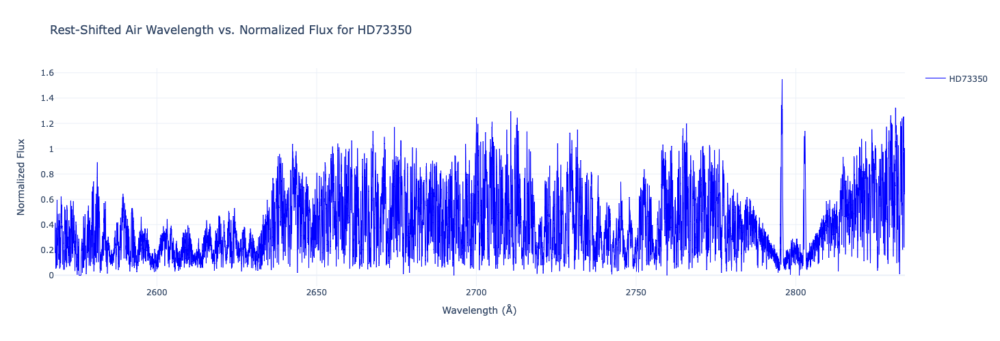

In [3]:
# running the overall function
rest_wls, norm_fluxes = spectra_to_rest(star_file)
aca_rest_wls, aca_norm_fluxes = spectra_to_rest(aca_file)

# plotting the results
fig = go.Figure()
fig.add_trace(go.Scatter(
    x = rest_wls,
    y = norm_fluxes,
    mode = 'lines',
    line = dict(color='blue', width=1),
    name = star_name
))
fig.update_layout(
    title=f'Rest-Shifted Air Wavelength vs. Normalized Flux for {star_name}',
    xaxis_title='Wavelength (Å)',
    yaxis_title='Normalized Flux',
    height=500,
    width=900,
    template='plotly_white',
    showlegend=True
)
fig.show()

Great, we have achieved a air-shifted rest spectrum for our star... right? But how can we actually know? To check the accuracy of our fit lets pull in the FeI rest wavelengths that are visible within this spectrum and see if they line up as expected. The UV air wavelengths are stored in the `lines.csv` file and we will filter by FeI and the bounds of the spectrum. We can also highlight the accepted positions of the MgII h and k emission lines, given [here](http://astronomy.nmsu.edu/drewski/tableofemissionlines.html), which are prominent UV coronal features in these stars. (Pro tip: to zoom into a portion of the plot, hold and drag an area you want to zoom in on. To return to the original state, double-click anywhere on the graph.)

In [4]:
# unpack FeI lines from lines.csv
lines_csv = 'data/shifting_data/lines.csv'
lines_table = pd.read_csv(lines_csv, sep='\s+', header=None)
lines_table.columns = ['ID', 'Wavelength', 'Elow', 'log(gf)', 'r_log(gf)', 'l_log(eps)(X)', 'log(eps)(X)']   #only really care about first two

fei_rows = lines_table[lines_table['ID'] == 'FeI']
fei_wls = np.array(fei_rows['Wavelength'])
star_mask = (fei_wls >= rest_wls.min()) & (fei_wls <= rest_wls.max())
star_fei_wls = fei_wls[star_mask]

# defining MgII h and k lines
mgii_wls = [2795.528, 2802.705]   # from NIST (2010)


# plotting spectrum again with FeI/MgII lines (using lots of plotly magic)
fig = go.Figure()

fig.add_trace(go.Scatter(
    x = rest_wls,
    y = norm_fluxes,
    mode = 'lines',
    line = dict(color='blue', width=1),
    name = star_name
))

for fei_wl in star_fei_wls:
    fig.add_trace(go.Scatter(
        x = [fei_wl, fei_wl],
        y = [0, 1.6],
        mode = 'lines', 
        line = dict(color='black', width=2, dash='dash'), 
        hovertemplate = f'Fe I rest line: {fei_wl} Å<extra></extra>',
        showlegend = False
    ))

# dummy line for general FeI legend entry
fig.add_trace(go.Scatter(
    x = [star_fei_wls[0], star_fei_wls[0]],
    y = [0, 1.6],
    mode = 'lines', 
    line = dict(color='black', width=2, dash='dash'), 
    hoverinfo = 'skip',
    name = 'FeI lines',
    showlegend=True
))

for mgii_wl in mgii_wls:
    fig.add_trace(go.Scatter(
        x = [mgii_wl, mgii_wl], 
        y = [0, 1.6],
        mode = 'lines', 
        line = dict(color='red', width=2, dash='dash'),
        hovertemplate = f'Mg II rest line: {mgii_wl} Å<extra></extra>',
        showlegend = False
    ))

# dummy line for general MgII legend entry
fig.add_trace(go.Scatter(
    x = [mgii_wls[0], mgii_wls[0]],
    y = [0, 1.6],
    mode = 'lines', 
    line = dict(color='red', width=2, dash='dash'), 
    hoverinfo = 'skip',
    name = 'MgII lines',
    showlegend=True
))

fig.update_layout(
    title=f'Rest-Shifted Air Wavelength vs. Normalized Flux for {star_name}',
    xaxis_title='Wavelength (Å)',
    yaxis_title='Normalized Flux',
    height=500,
    width=900,
    template='plotly_white',
    showlegend=True
)
fig.show()

Wow! Zooming in on the FeI absorption lines shows that it lines up with significant dips in the spectrum. Further, by confirming our MgII emission lines match the expected locations, we can determine that our shift is pretty spot-on! Reminder, all one needs to do using this option is feed a .fits file into the `spectra_to_rest` function. However, in the current iteration of this code, the function will raise errors if the spectra does not overlap with the $\alpha$ Centauri A basis spectrum (~2666 - 2932 Å).

## Option 2: The Hard Way (Using a String of Functions)

Curious how we got to our result in Option 1? This method shows the "behind-the-scenes" approach by unpacking all of the processes that we used to produce the overall `spectra_to_rest` function.

First we begin with a rough fitting of our continuum. This is done by first loading in the spectrum (using `load_spectrum`) which unpacks the fits file into raw wavelength and flux values and omits any non-finite values of these arrays. We then plug these values into `define_envelope`, which identifies an upper spectral envelope using local maxima in a string of windows over the spectrum. It is important to note that we omit flux values that are abnormally high (likely due to bad pixels), $\leq 0$, or within the expected range of MgII emission lines, as these all throw off the fitting process. Lastly, we use Gaussian processes with ideal parameters determined through reduced chi-squared analysis to fit our envelope points. This gives us our final, rough continuum fit.

In [5]:
# Step 1: Load in the raw data from our stellar spectrum
star_wls, star_fluxes = load_spectrum(star_file)

# Step 2: Defining an upper envelope
env_wls, env_fluxes = define_envelope(star_wls, star_fluxes)

# Step 3: Fitting the envelope with Gaussian processes
continuum, std = fit_continuum(star_wls, env_wls, env_fluxes)

# Plotting results so far
fig = go.Figure()
fig.add_trace(go.Scatter(
    x = star_wls, 
    y = star_fluxes,
    mode = 'lines',
    line = dict(color='blue', width=1),
    name = f'Raw {star_name} spectrum',
    showlegend = True
))
fig.add_trace(go.Scatter(
    x = env_wls,
    y = env_fluxes,
    mode = 'lines',
    line = dict(color='black', width=1),
    name = 'Stellar Envelope Fit',
    showlegend = True
))
fig.add_trace(go.Scatter(
    x = star_wls,
    y = continuum, 
    mode = 'lines',
    line = dict(color='salmon', width=2),
    name = 'Continuum Fit',
    showlegend = True
))
fig.update_layout(
    title=f'Continuum Fitting Process for {star_name}',
    xaxis_title='Wavelength (Å)',
    yaxis_title='Flux',
    height=500,
    width=900,
    template='plotly_white',
    showlegend=True
)
fig.show()

We have our rough continuum ... now what? We normalize our spectrum of course! Notice how from ~2650 - 2700 Å there is a flatter portion to the continuum fit? That is actually a feature we explored that is prevalent in all of the stars in our sample. Though it does have some ups and downs in this region, taking the median continuum value over this interval should accurately provide a normalization value to place all of the spectra into similar states, as we hope to compare many different spectra at different flux magnitudes. Thus, `normalize_spectrum` uses this method to normalize our spectra to common flux grids, and if one wanted to skip steps 1-3 for a simplified process, `normalize_spectrum_from_file` can be used as we do to normalize $\alpha$ Centauri A. We then can start the cross-correlation process.

In [6]:
# Step 4: Get normalized flux values (for HD73350 and Alpha Cen A)
star_norm_fluxes = normalize_spectrum(star_wls, star_fluxes, continuum)
aca_norm_fluxes = normalize_spectrum_from_file(aca_file)

# Getting Alpha Cen wavelengths
aca_wls, _ = load_spectrum(aca_file)

# Plotting results
fig = go.Figure()
fig.add_trace(go.Scatter(
    x = star_wls,
    y = star_norm_fluxes, 
    mode = 'lines',
    name = f'{star_name} Normalized Spectrum',
    showlegend = True
))
fig.add_trace(go.Scatter(
    x = aca_wls,
    y = aca_norm_fluxes,
    mode = 'lines',
    name = 'Alpha Centauri A Normalized Spectrum',
    showlegend = True
))
fig.update_layout(
    title=f"Comparing Normalized Spectra for {star_name} and Alpha Centauri A",
    xaxis_title='Wavelength (Å)',
    yaxis_title='Flux (Normalized)',
    height=500,
    width=900,
    template='plotly_white',
    showlegend=True
)
fig.show()

Since we normalized our spectrum, now we can directly compare it to another star, say $\alpha$ Centauri A! Notice that, though the spectra are close, they do not overlap exactly. This is due to a difference in radial velocity measurements, which are tough to determine in their own right. Luckily, due to how much it has been studied, there are good constraints on the radial velociy measurement of $\alpha$ Centauri A. So, if we can enact a wavelength shift to put our spectra into comparable $\alpha$ Centauri A wavelengths, we can determine the rest spectrum using the known radial velocity measurement. Finding our needed wavelength shift is done through a process called **cross-correlation** -- an automated process that slides a spectrum across a basis spectrum ($\alpha$ Centauri A in this case) and "matches" the two when errors between the flux values are minimized. Our $\alpha$ Centauri A basis spectrum (`aca_file`) was determined through examination of signal-to-noise ratios, and functionalities for it are already built into the `spectra_to_rest` function. Running `cross_correlate` for the spectral fluxes over a common wavelength grid will determine the necessary wavelength shift.

In [7]:
# Step 5: Define a common wavelength and flux grid

# Determine a common wavelength grid
wl_min = max(star_wls.min(), aca_wls.min())
wl_max = min(star_wls.max(), aca_wls.max())
    
common_wl = np.linspace(max(star_wls.min(), aca_wls.min()), min(star_wls.max(), aca_wls.max()), min(len(star_wls), len(aca_wls)))

# Interpolate normalized continuum fluxes to common wavelength grid
interp_star = interp1d(star_wls, star_norm_fluxes, kind='linear', bounds_error=False, fill_value='extrapolate')
interp_aca = interp1d(aca_wls, aca_norm_fluxes, kind='linear', bounds_error=False, fill_value='extrapolate')

new_star_norm_fluxes = interp_star(common_wl)
new_aca_norm_fluxes = interp_aca(common_wl)


# Step 6: Cross-correlate to find wavelength shift
shift, _, err = cross_correlate(new_aca_norm_fluxes, new_star_norm_fluxes, wave_a=common_wl, wave_b=common_wl)
print(f'Calculated {shift:.3f} Å (err: {err:.3f}) shift between {star_name} and Alpha Cen A.')


# Plot shifted spectra
fig = go.Figure()
fig.add_trace(go.Scatter(
    x = star_wls + shift,
    y = star_norm_fluxes,
    mode = 'lines',
    name = f'{star_name} Normalized Spectrum, Shifted',
    showlegend = True
))
fig.add_trace(go.Scatter(
    x = aca_wls,
    y = aca_norm_fluxes,
    mode = 'lines', 
    name = 'Alpha Cen A Normalized Basis Spectrum',
    showlegend = True
))
fig.update_layout(
    title=f"Comparing Shifted Spectra for {star_name} and Alpha Centauri A",
    xaxis_title='Wavelength (Å)',
    yaxis_title='Flux (Normalized)',
    height=500,
    width=900,
    template='plotly_white',
    showlegend=True
)
fig.show()

Calculated -0.506 Å (err: 0.024) shift between HD73350 and Alpha Cen A.


Now that we have matched our HD73350 spectrum with our $\alpha$ Cen A basis spectrum, we can shift by the median RV from SIMBAD (-22.4), shift all of the wavelengths into their air rest wavelengths (versus the vacuum rest wavelengths) and then evaluate the fit against the FeI lines from Option 1. We can then evaluate the average offset and apply it for the final fit. These steps are completed through the `rv_to_rest`, `air_conversion`, and `feii_shift` functions, respectively.

In [8]:
# Step 7: Shift by Alpha Cen RV
shifted_wls = star_wls + shift
star_rv_wls = rv_to_rest(shifted_wls)

# Step 8: Convert from vaccum rest to air rest
air_rest_wls = air_conversion(star_rv_wls)

# Step 9: Apply average offset of FeI absorption lines to accepted values
final_rest_wls = feii_shift(air_rest_wls)


# Plotting final results against FeI/MgII lines
fig = go.Figure()

fig.add_trace(go.Scatter(
    x = final_rest_wls,
    y = star_norm_fluxes,
    mode = 'lines',
    line = dict(color='blue', width=1),
    name = f'{star_name} Spectrum'
))

for fei_wl in star_fei_wls:
    fig.add_trace(go.Scatter(
        x = [fei_wl, fei_wl],
        y = [0, 1.6],
        mode = 'lines', 
        line = dict(color='black', width=2, dash='dash'), 
        hovertemplate = f'Fe I rest line: {fei_wl} Å<extra></extra>',
        showlegend = False
    ))

# dummy line for general FeI legend entry
fig.add_trace(go.Scatter(
    x = [star_fei_wls[0], star_fei_wls[0]],
    y = [0, 1.6],
    mode = 'lines', 
    line = dict(color='black', width=2, dash='dash'), 
    hoverinfo = 'skip',
    name = 'FeI lines',
    showlegend=True
))

for mgii_wl in mgii_wls:
    fig.add_trace(go.Scatter(
        x = [mgii_wl, mgii_wl], 
        y = [0, 1.6],
        mode = 'lines', 
        line = dict(color='red', width=2, dash='dash'),
        hovertemplate = f'Mg II rest line: {mgii_wl} Å<extra></extra>',
        showlegend = False
    ))

# dummy line for general MgII legend entry
fig.add_trace(go.Scatter(
    x = [mgii_wls[0], mgii_wls[0]],
    y = [0, 1.6],
    mode = 'lines', 
    line = dict(color='red', width=2, dash='dash'), 
    hoverinfo = 'skip',
    name = 'MgII lines',
    showlegend=True
))

fig.update_layout(
    title=f'Rest-Shifted Air Wavelength vs. Normalized Flux for {star_name}',
    xaxis_title='Wavelength (Å)',
    yaxis_title='Normalized Flux',
    height=500,
    width=900,
    template='plotly_white',
    showlegend=True
)
fig.show()

## Graphical Comparison of Options 1 and 2

Now that we have seen both processes in action, where Option 2 is just the "behind-the-scenes" view of Option 1, they should plot over one another, right? Let's test that!

In [9]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    x = rest_wls,
    y = norm_fluxes,
    mode = 'lines',
    line = dict(color='blue', width=2),
    name = 'Option 1'
))

fig.add_trace(go.Scatter(
    x = final_rest_wls,
    y = star_norm_fluxes,
    mode = 'lines',
    line = dict(color='salmon', width=1),
    name = 'Option 2'
))

fig.update_layout(
    title=f'Result of Air-Rest Shifting Process by Option for {star_name}',
    xaxis_title='Wavelength (Å)',
    yaxis_title='Normalized Flux',
    height=500,
    width=900,
    template='plotly_white',
    showlegend=True
)
fig.show()

Yay, they match as expected! Now go forth and put some more solar-like spectra into analysis-ready format!